In [1]:
import pandas as pd
import numpy as np
import json
import os
import datetime as dt

from pandas_datareader.data import DataReader
from sklearn.preprocessing import StandardScaler

from wordcloud import WordCloud

# further text processing
import gensim
from gensim.utils import simple_preprocess
import nltk
nltk.download('stopwords')
from nltk.corpus import stopwords
import gensim.corpora as corpora

# plotting
import matplotlib.pyplot as plt
import seaborn as sns
from pandas.plotting import autocorrelation_plot
sns.set_style("dark")
sns.set_context("talk")
sns.set(rc = {'figure.figsize':(20,10)}, font_scale=1.5)

# custom functions
from modules import functions

# vader sentiment
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\lapen\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


# Sentiment Scoring

In [2]:
# set up tweets
fp = '../data/tweets/raw/netflix_tweets_v2.json'

tweets = []
for line in open(fp, 'r'):
    tweets.append(json.loads(line))

tweets_df = pd.DataFrame(tweets)

In [3]:
# remove duplicates
tweets_df.drop_duplicates(subset='tweet_id', inplace=True)
tweets_df.shape

(51643, 4)

In [4]:
# sentiment analysis
analyzer = SentimentIntensityAnalyzer()
compound_scores = []
cat_pred = []
for sentence in tweets_df['tweet_text']:
    vs = analyzer.polarity_scores(sentence)
    print(str(vs)+' ##### '+sentence)
    compound_scores.append(vs['compound'])
    if vs['compound'] >= 0.05:
        cat_pred.append('positive')
    elif vs['compound'] > -0.05 and vs['compound'] < 0.05:
        cat_pred.append('neutral')
    else:
        cat_pred.append('negative')
    print(vs)

{'neg': 0.0, 'neu': 0.791, 'pos': 0.209, 'compound': 0.8908} ##### About 80% of @Netflix subscribers usually watch with subtitles or closed captions (though only ~25% of those aged 56-75). 
Many of #Netflix’s best shows, including its most popular show to date, @NetflixKR's Squid Game, are enjoyed by audiences who can't understand the language.
{'neg': 0.0, 'neu': 0.791, 'pos': 0.209, 'compound': 0.8908}
{'neg': 0.0, 'neu': 0.76, 'pos': 0.24, 'compound': 0.8602} ##### @DiscussingFilm @MTVNEWS #blockbuster #BlackPantherWakandaForever #movies #netflix #film #acting #rent #nfts
https://t.co/ZyUeiFUBNh
BLOCKBUSTER VIDEO AUTHENTIC MEMBERSHIP CARD NOSTALGIA 80'S 90'S NFT
only 10 remaining in the world🌍
{'neg': 0.0, 'neu': 0.76, 'pos': 0.24, 'compound': 0.8602}
{'neg': 0.109, 'neu': 0.552, 'pos': 0.339, 'compound': 0.9337} ##### Gremlins #KZN soon on #Netflix'e Mfs😉😂🤣😂😂🤣
Duma #ANCKZNconference 
#VoetsekANC https://t.co/dBaLtpbkOY
{'neg': 0.109, 'neu': 0.552, 'pos': 0.339, 'compound': 0.9337}


compound score meanings: <br>
positive sentiment: compound score >= 0.05 <br>
neutral sentiment: (compound score > -0.05) and (compound score < 0.05) <br>
negative sentiment: compound score <= -0.05 <br>

In [5]:
# merge values back to df
tweets_df['tweet_sentiment_score'] = compound_scores
tweets_df['tweet_sentiment_cat'] = cat_pred
tweets_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 51643 entries, 0 to 51642
Data columns (total 6 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   tweet_id               51643 non-null  object 
 1   author_id              51643 non-null  object 
 2   created_at             51643 non-null  object 
 3   tweet_text             51643 non-null  object 
 4   tweet_sentiment_score  51643 non-null  float64
 5   tweet_sentiment_cat    51643 non-null  object 
dtypes: float64(1), object(5)
memory usage: 2.8+ MB


In [6]:
# turn dates to datetime
tweets_df['created_at'] = pd.to_datetime(tweets_df['created_at'])
tweets_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 51643 entries, 0 to 51642
Data columns (total 6 columns):
 #   Column                 Non-Null Count  Dtype              
---  ------                 --------------  -----              
 0   tweet_id               51643 non-null  object             
 1   author_id              51643 non-null  object             
 2   created_at             51643 non-null  datetime64[ns, UTC]
 3   tweet_text             51643 non-null  object             
 4   tweet_sentiment_score  51643 non-null  float64            
 5   tweet_sentiment_cat    51643 non-null  object             
dtypes: datetime64[ns, UTC](1), float64(1), object(4)
memory usage: 2.8+ MB


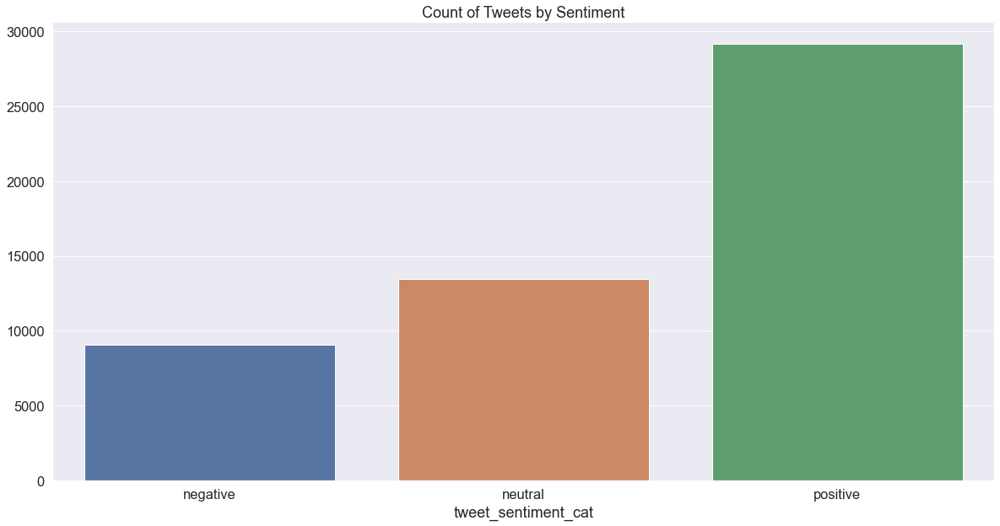

In [7]:
sentiment_counts = pd.DataFrame(tweets_df.groupby('tweet_sentiment_cat')['tweet_sentiment_cat'].count())
sns.barplot(data=sentiment_counts.T).set(title='Count of Tweets by Sentiment')
plt.show()

# LDA

In [8]:
# text preprocessing
nflxstop = ['netflix', 'http', 'croge', 'squidcrowge']

lda_df = tweets_df.copy()
lda_df['tweet_text'] = functions.text_preprocessing(pd.DataFrame(lda_df['tweet_text']), nflxstop)

netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix
http
croge
squidcrowge
netflix


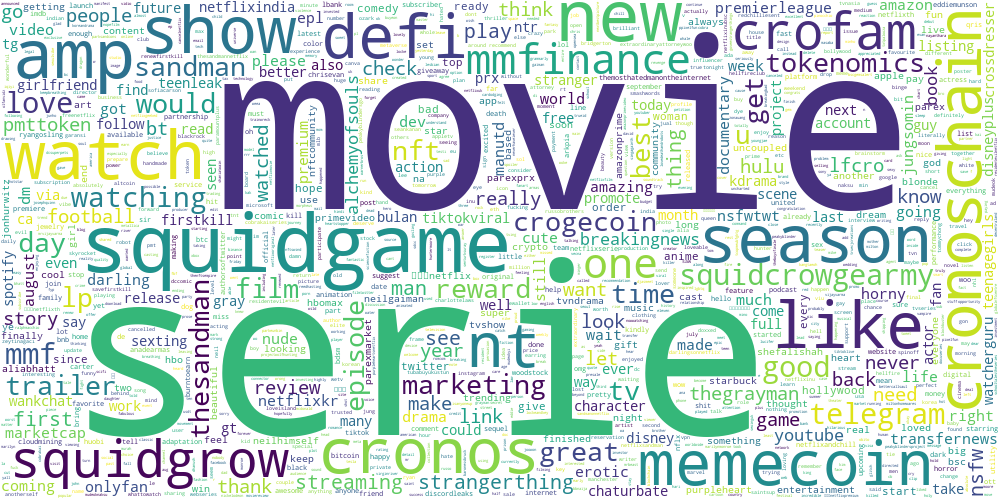

In [9]:
# wordcloud

# join all titles together
all_string = ",".join(list(lda_df['tweet_text'].values))

# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=5000, contour_width=3, contour_color='steelblue',
                        width=1000, height=500, stopwords=nflxstop, collocations=False)

# Generate a word cloud
wordcloud.generate(all_string)

# Visualize the word cloud
wordcloud.to_image()

In [19]:
lda_df.head()

,tweet_id,author_id,created_at,tweet_text,tweet_sentiment_score,tweet_sentiment_cat
0,1551311044789751808,67146757,2022-07-24 20:59:09+00:00,subscriber usually watch subtitle closed capti...,0.8908,positive
1,1551311072065474560,1405294373391241217,2022-07-24 20:59:16+00:00,discussingfilm mtvnews blockbuster blackpanthe...,0.8602,positive
2,1551311220929662980,944149608992854017,2022-07-24 20:59:51+00:00,gremlin kzn soon e duma anckznconference voets...,0.9337,positive
3,1551311241834029056,1544792874453291008,2022-07-24 20:59:56+00:00,tenzilamazhar stranger thing,0.0000,neutral
4,1551311256530784257,1291356766924451840,2022-07-24 21:00:00+00:00,counting day till drop wed ca nt arrive fast e...,0.0000,neutral


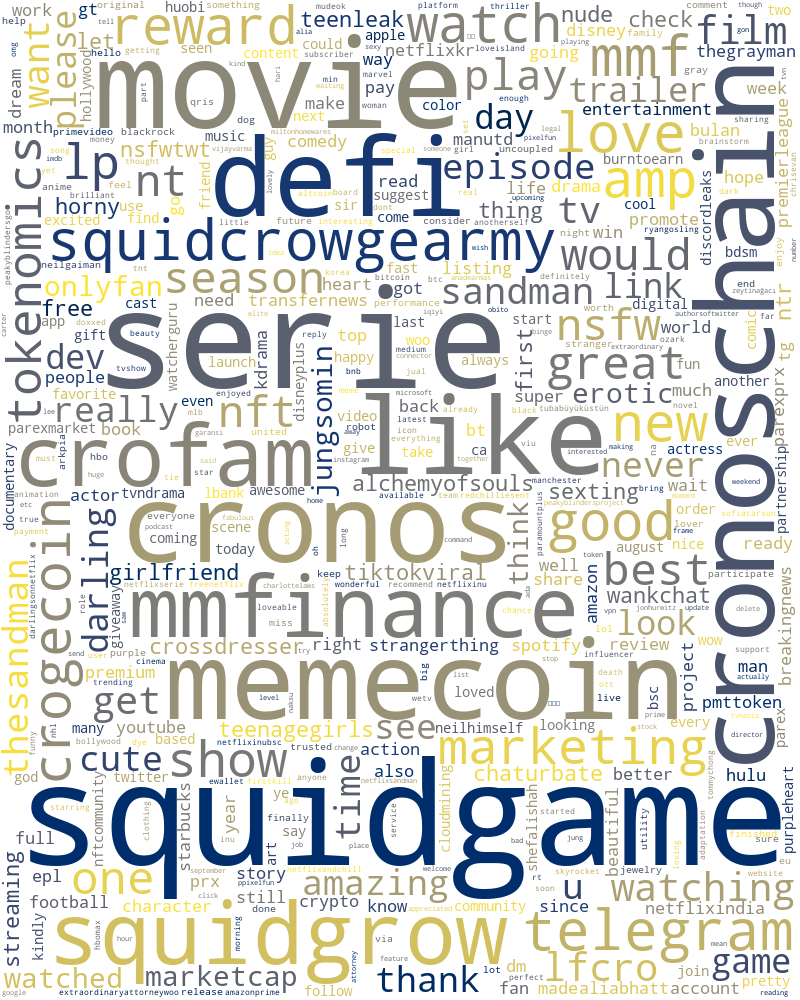

In [36]:
# positive

# join all titles together
all_string = ",".join(list(lda_df[lda_df.tweet_sentiment_cat == 'positive']['tweet_text'].values))

# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=500, contour_width=3, contour_color='steelblue',
                        width=800, height=1000, stopwords=nflxstop, collocations=False, colormap='cividis')

# Generate a word cloud
wordcloud.generate(all_string)

# Visualize the word cloud
wordcloud.to_image()

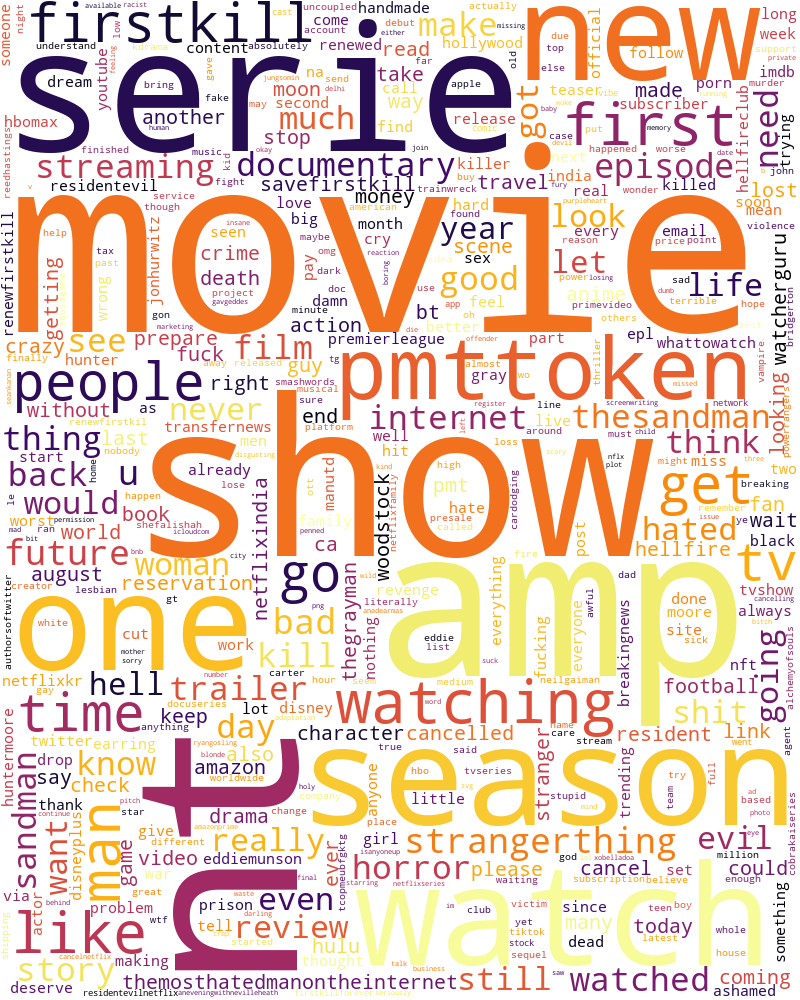

In [37]:
# positive

# join all titles together
all_string = ",".join(list(lda_df[lda_df.tweet_sentiment_cat == 'negative']['tweet_text'].values))

# Create a WordCloud object
wordcloud = WordCloud(background_color="white", max_words=500, contour_width=3, contour_color='steelblue',
                        width=800, height=1000, stopwords=nflxstop, collocations=False, colormap='inferno')

# Generate a word cloud
wordcloud.generate(all_string)

# Visualize the word cloud
wordcloud.to_image()

In [10]:
# LDA data prediction

def sent_to_words(sentences):
    for sentence in sentences:
        # deacc=True removes punctuations
        yield(gensim.utils.simple_preprocess(str(sentence), deacc=True))

# move text to list
data = lda_df.tweet_text.values.tolist()
data_words = list(sent_to_words(data))
data_words



[['subscriber',
  'usually',
  'watch',
  'subtitle',
  'closed',
  'caption',
  'though',
  'aged',
  'many',
  'best',
  'show',
  'including',
  'popular',
  'show',
  'date',
  'netflixkr',
  'squid',
  'game',
  'enjoyed',
  'audience',
  'ca',
  'nt',
  'understand',
  'language'],
 ['discussingfilm',
  'mtvnews',
  'blockbuster',
  'movie',
  'film',
  'acting',
  'rent',
  'nfts',
  'http',
  'tcozyueifubnh',
  'blockbuster',
  'video',
  'authentic',
  'membership',
  'card',
  'nostalgia',
  'nft',
  'remaining'],
 ['gremlin', 'kzn', 'soon', 'duma', 'voetsekanc', 'http', 'tcodbaltpbkoy'],
 ['tenzilamazhar', 'stranger', 'thing'],
 ['counting',
  'day',
  'till',
  'drop',
  'wed',
  'ca',
  'nt',
  'arrive',
  'fast',
  'enough',
  'check',
  'last',
  'week',
  'krushoftheweek',
  'parkeunbin',
  'http',
  'hellomytwenties',
  'hotstoveleague',
  'doyoulikebrahms',
  'bingo'],
 ['parexprx',
  'happy',
  'sunday',
  'kindly',
  'suggest',
  'check',
  'parex',
  'news',
  'nev

In [11]:
# create dict
id2word = corpora.Dictionary(data_words)

# create corpus
texts = data_words

# Term document frequency
corpus = [id2word.doc2bow(text) for text in texts]

# check
print(corpus[:1][0][:30])

[(0, 1), (1, 1), (2, 1), (3, 1), (4, 1), (5, 1), (6, 1), (7, 1), (8, 1), (9, 1), (10, 1), (11, 1), (12, 1), (13, 1), (14, 1), (15, 2), (16, 1), (17, 1), (18, 1), (19, 1), (20, 1), (21, 1), (22, 1)]


In [12]:
from pprint import pprint
# number of topics
num_topics = 10
# Build LDA model
lda_model = gensim.models.LdaMulticore(corpus=corpus,
                                       id2word=id2word,
                                       num_topics=num_topics)
# Print the Keyword in the 10 topics
pprint(lda_model.print_topics())
doc_lda = lda_model[corpus]

[(0,
  '0.043*"http" + 0.014*"movie" + 0.007*"amp" + 0.006*"new" + 0.006*"series" + '
  '0.005*"man" + 0.005*"watch" + 0.004*"like" + 0.004*"film" + 0.004*"tv"'),
 (1,
  '0.054*"http" + 0.007*"like" + 0.007*"good" + 0.006*"nt" + 0.006*"watching" '
  '+ 0.006*"strangerthings" + 0.005*"series" + 0.005*"look" + 0.004*"show" + '
  '0.004*"season"'),
 (2,
  '0.037*"http" + 0.011*"pmttoken" + 0.008*"squidgame" + 0.007*"movie" + '
  '0.007*"series" + 0.006*"cronos" + 0.006*"cronoschain" + 0.006*"memecoin" + '
  '0.005*"defi" + 0.005*"future"'),
 (3,
  '0.072*"http" + 0.008*"movie" + 0.006*"new" + 0.006*"one" + 0.004*"review" + '
  '0.004*"like" + 0.004*"amp" + 0.004*"great" + 0.003*"show" + 0.003*"series"'),
 (4,
  '0.057*"http" + 0.008*"series" + 0.007*"nsfw" + 0.005*"telegram" + '
  '0.004*"love" + 0.004*"nft" + 0.004*"squidgame" + 0.004*"tv" + 0.004*"day" + '
  '0.004*"watch"'),
 (5,
  '0.068*"http" + 0.027*"squidgame" + 0.019*"series" + 0.015*"cronos" + '
  '0.015*"memecoin" + 0.015*"cron

In [13]:
import pyLDAvis.gensim_models as gensimvis
import pickle 
import pyLDAvis
# Visualize the topics
pyLDAvis.enable_notebook()
LDAvis_data_filepath = os.path.join('./results/ldavis_prepared_'+str(num_topics))
# # this is a bit time consuming - make the if statement True
# # if you want to execute visualization prep yourself
if 1 == 1:
    LDAvis_prepared = gensimvis.prepare(lda_model, corpus, id2word)
    # with open(LDAvis_data_filepath, 'wb') as f:
    #     pickle.dump(LDAvis_prepared, f)
# # load the pre-prepared pyLDAvis data from disk
# with open(LDAvis_data_filepath, 'rb') as f:
#     LDAvis_prepared = pickle.load(f)
pyLDAvis.save_html(LDAvis_prepared, 'ldavis_prepared_'+ str(num_topics) +'.html')
LDAvis_prepared

c:\Users\lapen\anaconda3\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
5      0.123287 -0.073729       1        1  16.274354
6     -0.080157 -0.064083       2        1  13.929183
3     -0.046628 -0.016829       3        1  12.543041
1     -0.033704  0.021196       4        1  10.036321
0     -0.017634 -0.025652       5        1   9.409182
9     -0.048871 -0.003988       6        1   8.567720
8      0.043400  0.100267       7        1   8.489451
7     -0.046540  0.046031       8        1   7.877105
4      0.056065  0.032899       9        1   6.773753
2      0.050783 -0.016112      10        1   6.099889, topic_info=              Term         Freq        Total Category  logprob  loglift
974      squidgame  3848.000000  3848.000000  Default  30.0000  30.0000
18801  cronoschain  2130.000000  2130.000000  Default  29.0000  29.0000
4104        cronos  2241.000000  2241.000000  Default  28.0000  28.0000
18800       crofam  2019.000000  2019.000000  Default  27.0000  27.0000
20494    mmfinance  1995.000000  1995.000000  Default  26.0000  26.0000
...            ...          ...          ...      ...      ...      ...
224           good   119.956479  1984.740849  Topic10  -5.8023  -0.0092
747      crogecoin   117.834244  1592.809357  Topic10  -5.8202   0.1929
15            show   117.824331  2384.600151  Topic10  -5.8203  -0.2107
569            new   116.672504  2213.171435  Topic10  -5.8301  -0.1459
22           watch   110.418551  2639.936190  Topic10  -5.8852  -0.3773

[840 rows x 6 columns], token_table=       Topic      Freq             Term
term                                   
3820       2  0.075829         academic
3820       4  0.075829         academic
3820       8  0.758294         academic
3820      10  0.075829         academic
13210      1  0.100142  accesshollywood
...      ...       ...              ...
13665      9  0.066902              이두나
13665     10  0.468317              이두나
15550      3  0.948232              𝐝𝐚𝐲
8661      10  0.692667              𝕋𝕙𝕖
9568       6  0.765606             𝗽𝗮𝗶𝗱

[3070 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[6, 7, 4, 2, 1, 10, 9, 8, 5, 3])

In [25]:
vis_data = gensimvis.prepare(lda_model, corpus, id2word)
pyLDAvis.save_html(vis_data, 'output_filename.html')

c:\Users\lapen\anaconda3\lib\site-packages\pyLDAvis\_prepare.py:246: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only
  default_term_info = default_term_info.sort_values(


# Daily

[Text(0.5, 1.0, 'Tweet Sentiment Score Distributions')]

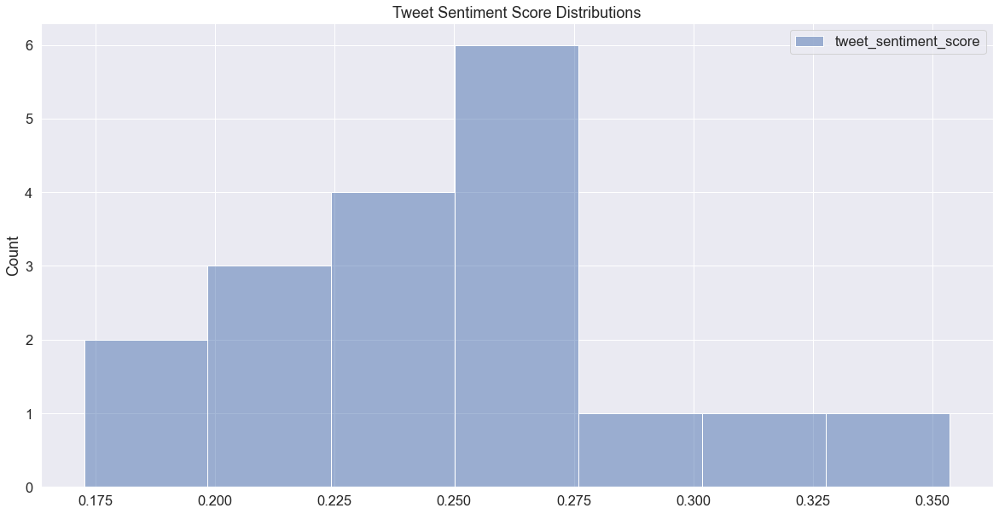

In [14]:
daily_tweets = tweets_df.groupby([tweets_df['created_at'].dt.date]).mean()
sns.histplot(daily_tweets).set(title='Tweet Sentiment Score Distributions')

In [15]:
daily_tweets.index = pd.to_datetime(daily_tweets.index)
daily_tweets.T

created_at,2022-07-24,2022-07-25,2022-07-26,2022-07-27,2022-07-28,2022-07-29,2022-07-30,2022-07-31,2022-08-01,2022-08-02,2022-08-03,2022-08-04,2022-08-05,2022-08-06,2022-08-07,2022-08-08,2022-08-09,2022-08-10
tweet_sentiment_score,0.172671,0.274499,0.25451,0.222315,0.229917,0.215619,0.31974,0.259813,0.257858,0.353554,0.187128,0.218744,0.2523,0.249985,0.279487,0.233285,0.229423,0.254876


[Text(0.5, 1.0, 'Tweet Sentiment Score by Day')]

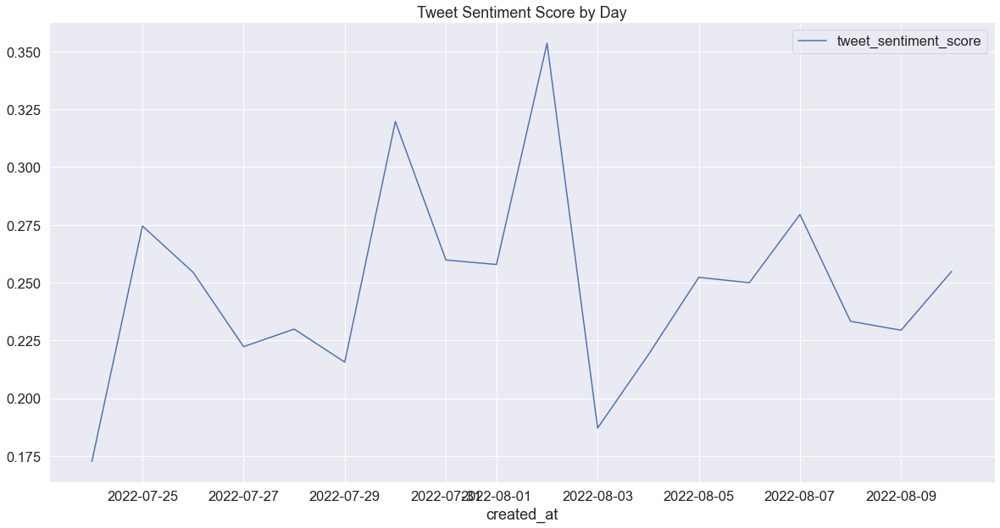

In [16]:
sns.lineplot(data=daily_tweets).set(title='Tweet Sentiment Score by Day')

In [17]:
daily_tweets

,tweet_sentiment_score
created_at,
2022-07-24,0.172671
2022-07-25,0.274499
2022-07-26,0.254510
2022-07-27,0.222315
2022-07-28,0.229917
2022-07-29,0.215619
2022-07-30,0.319740
2022-07-31,0.259813
2022-08-01,0.257858


In [18]:
# Important dates
start = dt.datetime(2022,7,23)
end = dt.datetime(2022,8,14)

nflx = DataReader("NFLX",  "yahoo", start, end)